<a href="https://colab.research.google.com/github/SrikantShubam/objectDetectionExtraction/blob/main/Part2_Using_Dectectron.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In the Part 2 we will be using Detectron2 for object detection 
In Part 1 most of the objects obtained were based whether the objects had enough countours or not but that didn't worked out very well so in this part we will be using 




1.  Detectron2 for detecting objects
2.  Using PIL library for extracting the detected objects
3.  Using Grabcut algorithm
4. Cropping the detected objects






![picture](https://drive.google.com/uc?export=view&id=1PbS4LBfwLbmw_E4J2F_ych9t0Umc8F6N)




## Detectron2

Detectron2 is a ground-up rewrite of Detectron that started with maskrcnn-benchmark. The platform is now implemented in PyTorch. With a new, more modular design, Detectron2 is flexible and extensible, and able to provide fast training on single or multiple GPU servers. Detectron2 includes high-quality implementations of state-of-the-art object detection algorithms, including DensePose, panoptic feature pyramid networks, and numerous variants of the pioneering Mask R-CNN model family also developed by FAIR. Its extensible design makes it easy to implement cutting-edge research projects without having to fork the entire codebase.

# Installing libraries
Please keep in mind that the version for pytorch is 1.7.1 with cu101 and cude_is_available() returns True if it doesn't go to Runtime (on the top ) select change runtime type and select **GPU**

In [ ]:
!pip install pyyaml==5.1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 274 kB 7.7 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=2d897c7732d7a9fd024a8e78c11e0d6993d1043777ae609747a9eaa3a54a029e
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [ ]:
!pip install torch==1.7.1+cu101 torchvision==0.8.2+cu101 torchaudio==0.7.2 -f https://download.pytorch.org/whl/torch_stable.html

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 735.4 MB 16 kB/s 
     |████████████████████████████████| 12.8 MB 19.3 MB/s 
     |████████████████████████████████| 7.6 MB 7.2 MB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.12.0+cu113
    Uninstalling torch-1.12.0+cu113:
      Successfully uninstalled torch-1.12.0+cu113
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.13.0+cu113
    Uninstalling torchvision-0.13.0+cu113:
      Successfully uninstalled torchvision-0.13.0+cu113
  Attempting uninstall: torchaudio
    Found existing installation: torchaudio 0.12.0+cu113
    Uninstalling torchaudio-0.12.0+cu113:
      Successfully uninstalled torchaudio-0.12.0+cu113
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. 

In [ ]:
import torch
print(torch.__version__, torch.cuda.is_available())

1.7.1+cu101 True


In [ ]:
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html


# Importing Detectron 2 

In [ ]:
import detectron2
from detectron2.utils.logger import setup_logger

setup_logger()
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog,DatasetCatalog
import cv2
from google.colab.patches import cv2_imshow

### We will be using instance segmentation in this part.
But what is [instance segmentation](https://blog.roboflow.com/detectron2-custom-instance-segmentation/) ?
 Object detection draws a bounding box and makes an object class classification around objects of interest. Instance segmentation takes object detection a step further and draws the outline around the object of interest. As a result, modeling is slightly more difficult and instance segmentation should only be used when the exact outline of the object is needed for your downstream application.

![picture](https://drive.google.com/uc?export=view&id=1gWKrz2wOXDcIrPZWZlFKYl6o8-qsllSf)



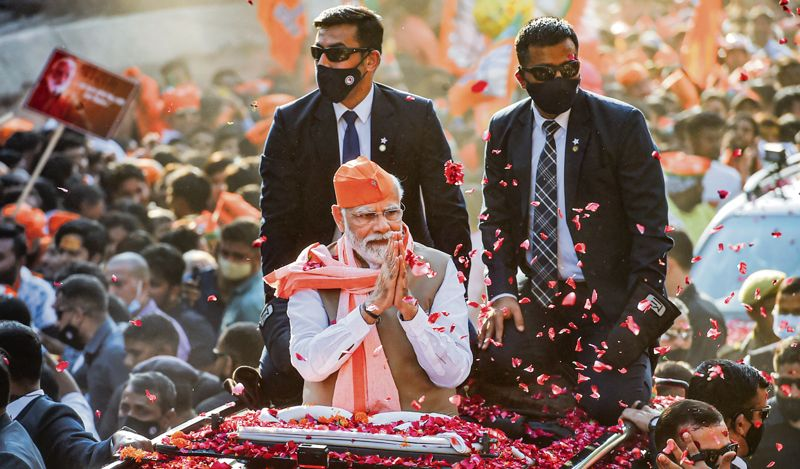

In [ ]:
image=cv2.imread("/content/2022_3$largeimg_1635010640.jpg")

cv2_imshow(image)

In [ ]:
cfg=get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_C4_3x.yaml"))  #the models which we will be using is mask_rcnn
cfg.MODEL.WEIGHTS=model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_C4_3x.yaml")

cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST=0.6

In [ ]:
predictor=DefaultPredictor(cfg)

model_final_4ce675.pkl: 144MB [00:03, 44.7MB/s]                           
The checkpoint state_dict contains keys that are not used by the model:
  proposal_generator.anchor_generator.cell_anchors.0


In [ ]:
outputs=predictor(image)

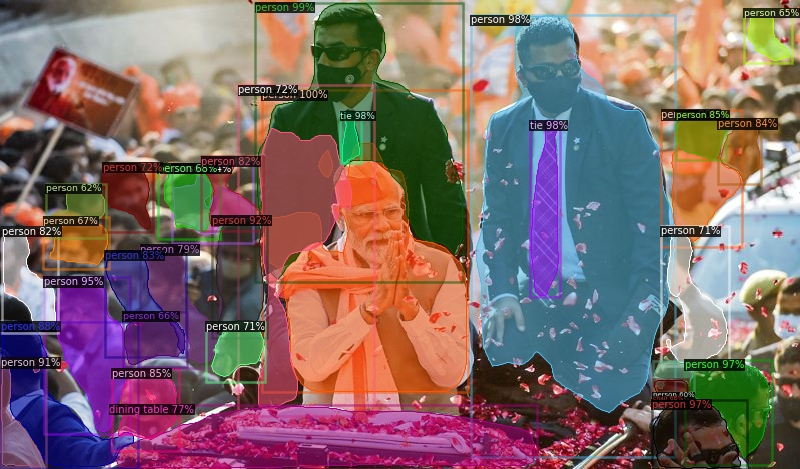

In [ ]:
viz=Visualizer(image[:,:,::-1],MetadataCatalog.get(cfg.DATASETS.TRAIN[0]))
output=viz.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(output.get_image()[:,:,::-1])

In [ ]:
count=len(outputs["instances"].pred_boxes)
print("The total detections in the image are",count)

The total detections in the image are 32


265 466 143 391


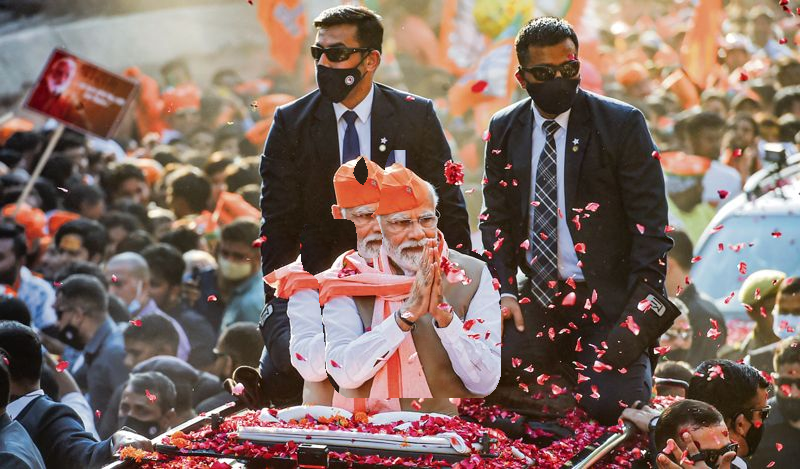

257 462 3 279


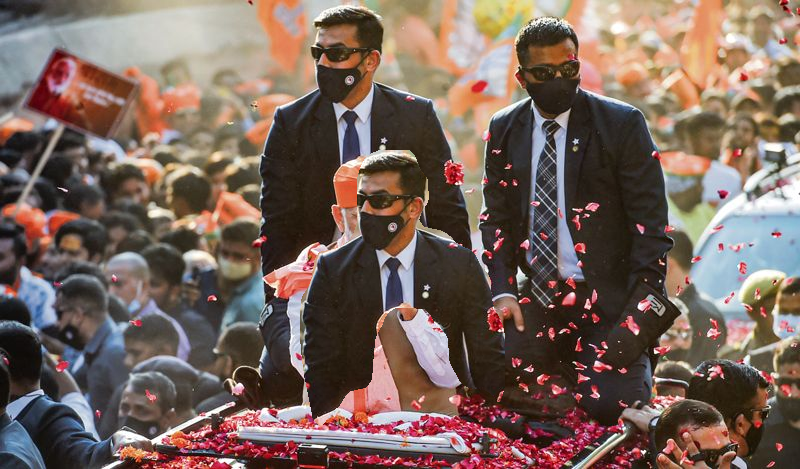

531 558 121 295


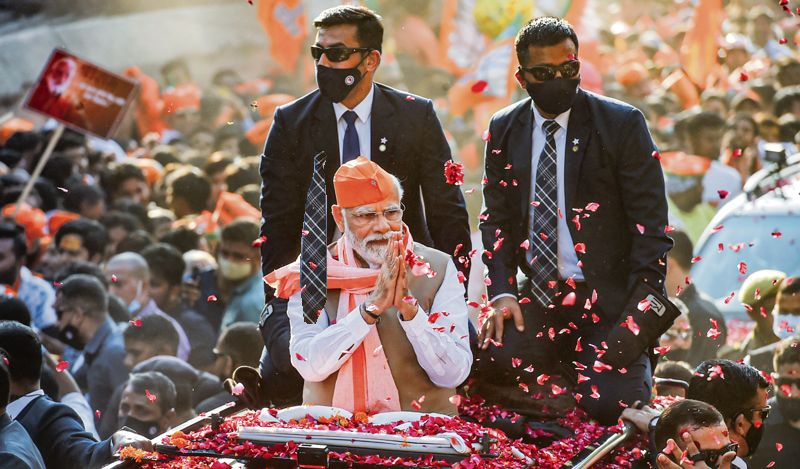

342 359 112 162


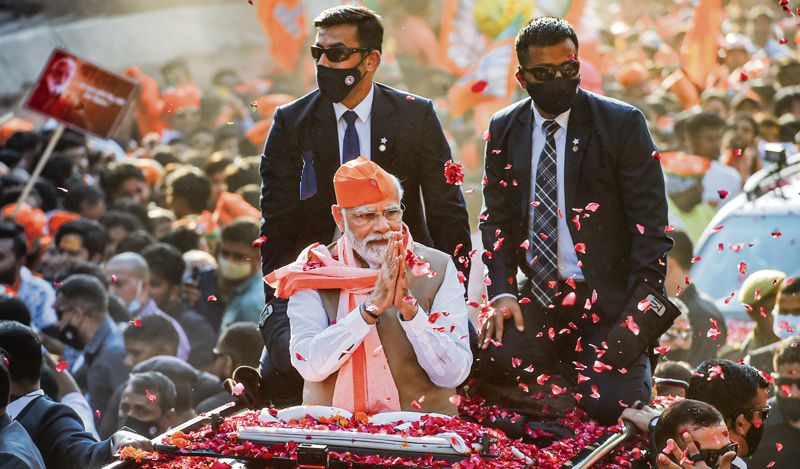

475 674 15 412


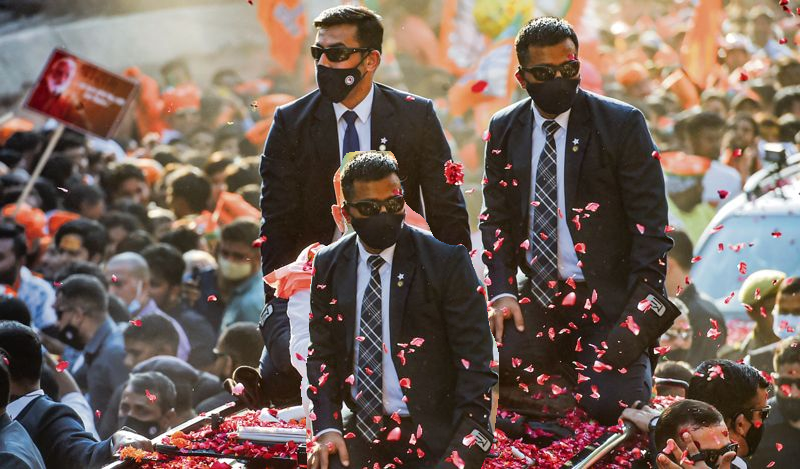

653 740 400 468


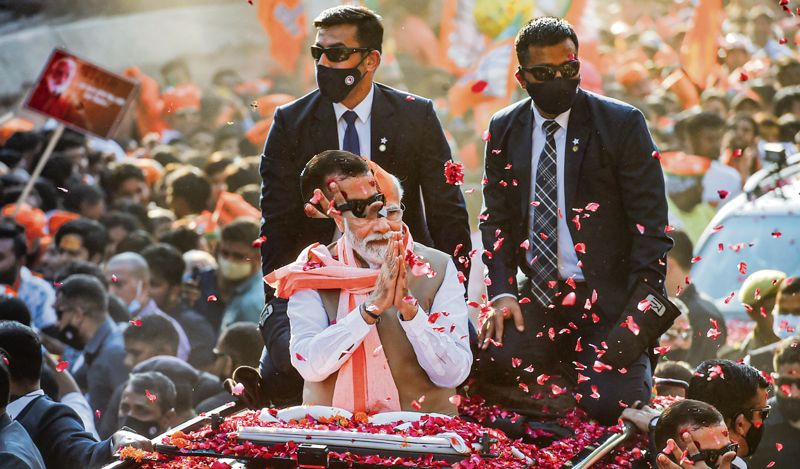

687 769 360 457


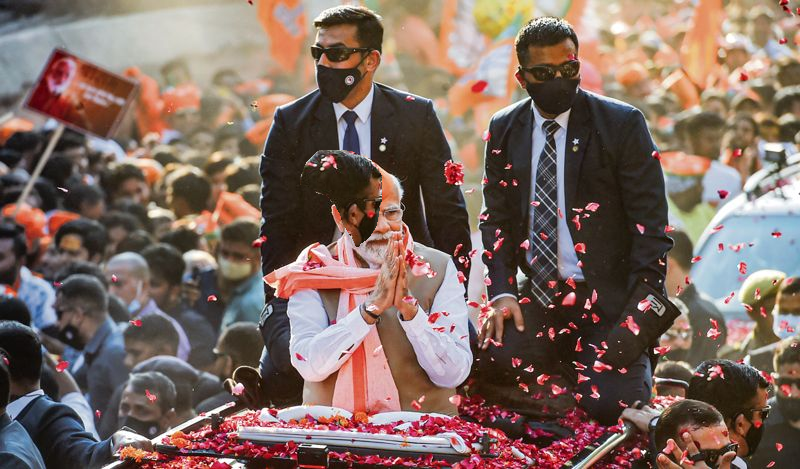

56 126 277 431


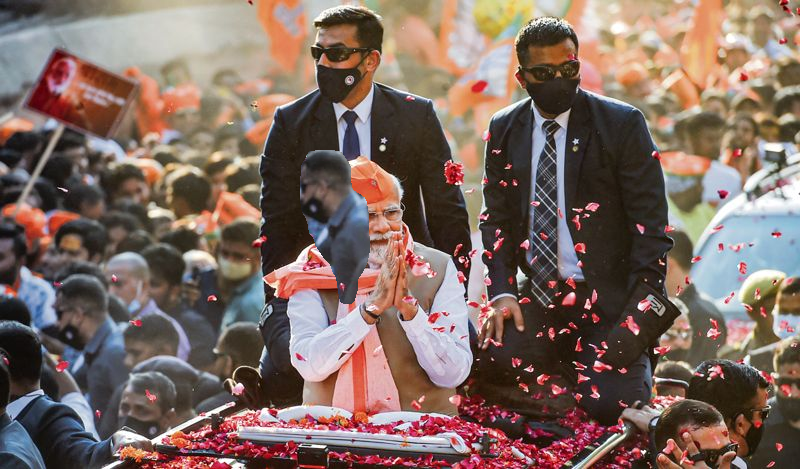

216 263 217 334


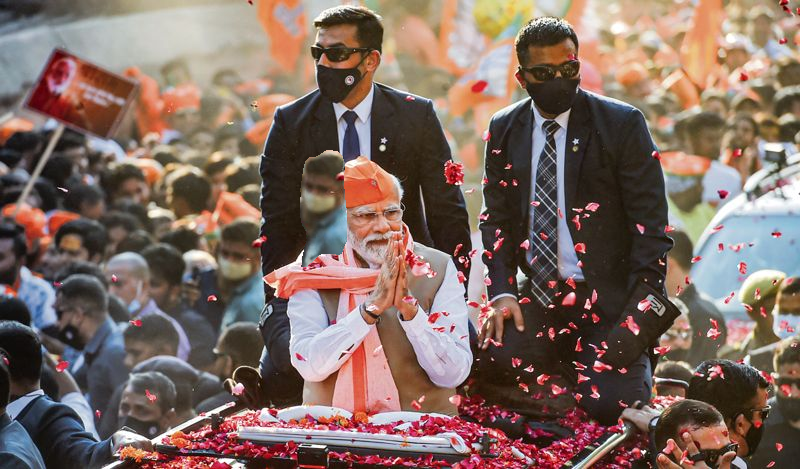

1 42 359 466


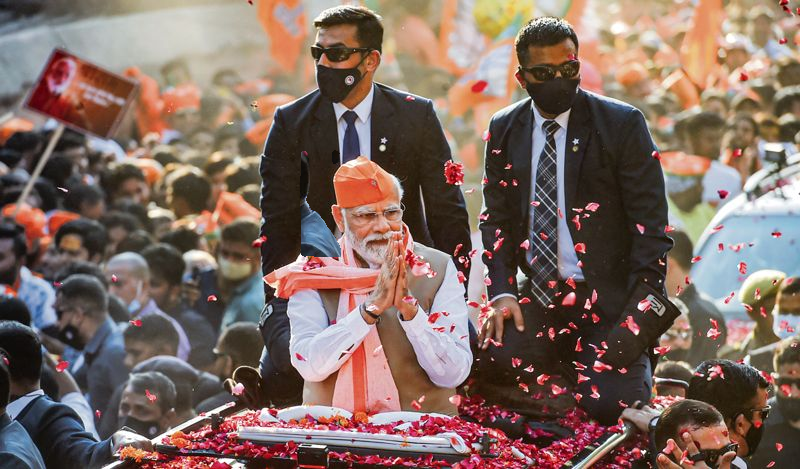

671 740 110 241


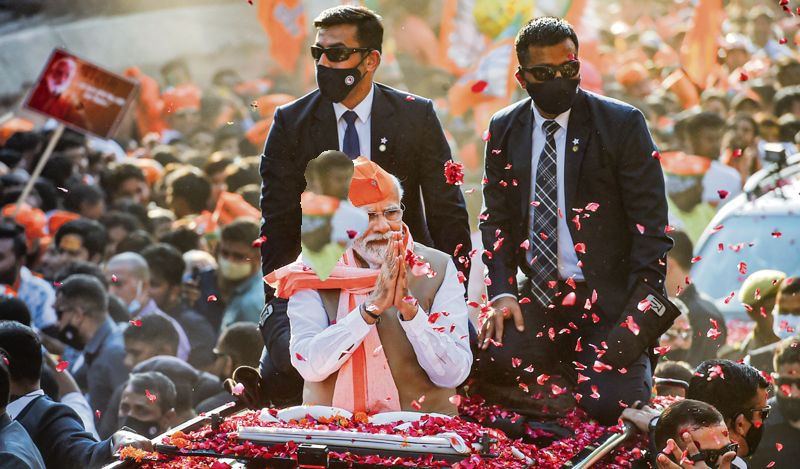

2 133 322 466


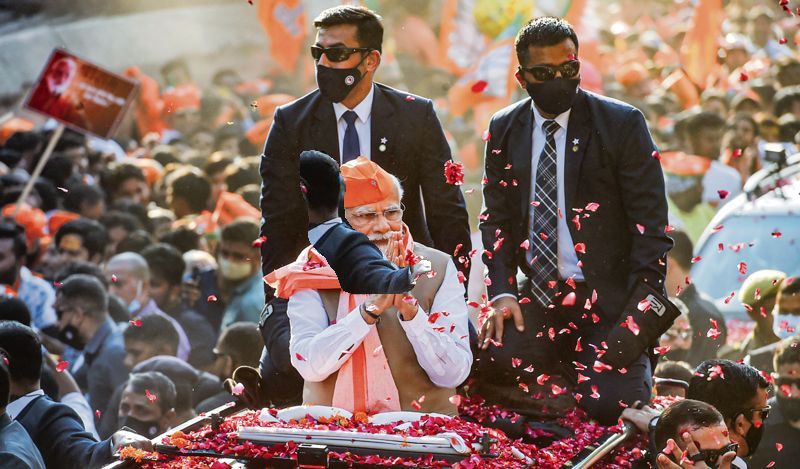

118 176 369 438


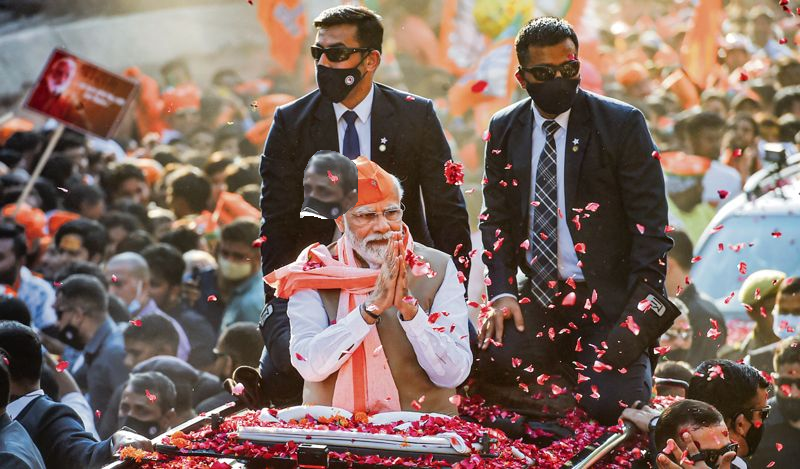

677 724 111 158


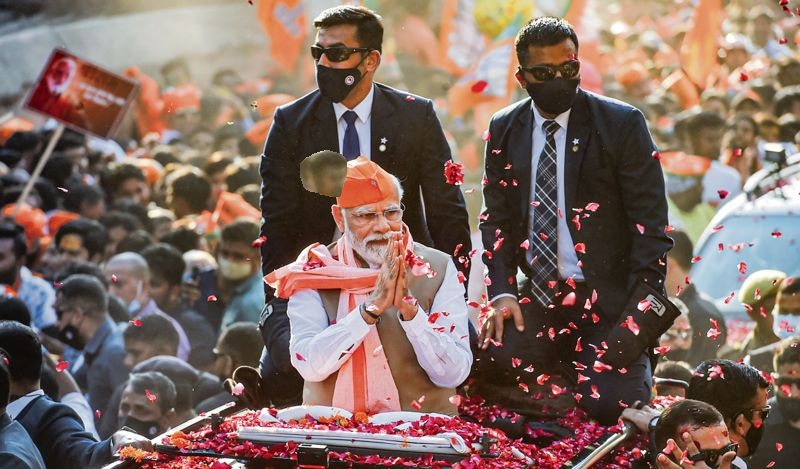

720 759 119 181


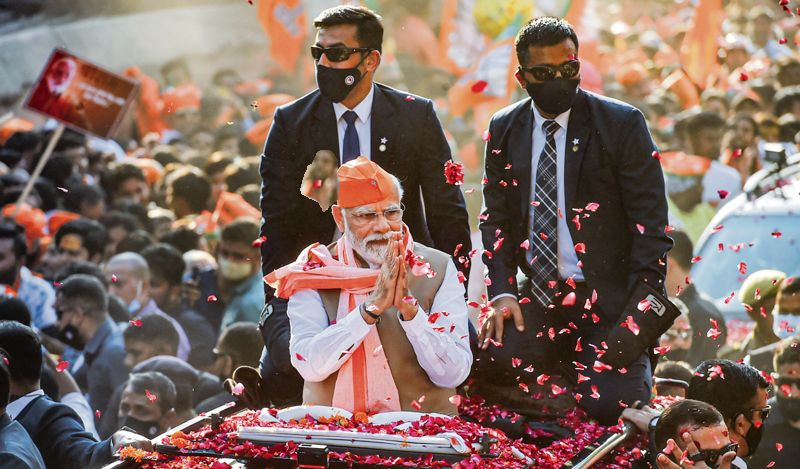

105 184 251 353


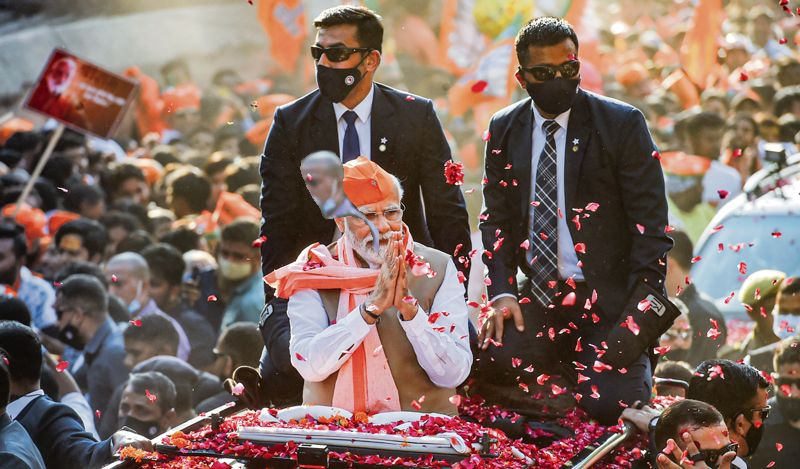

3 55 228 329


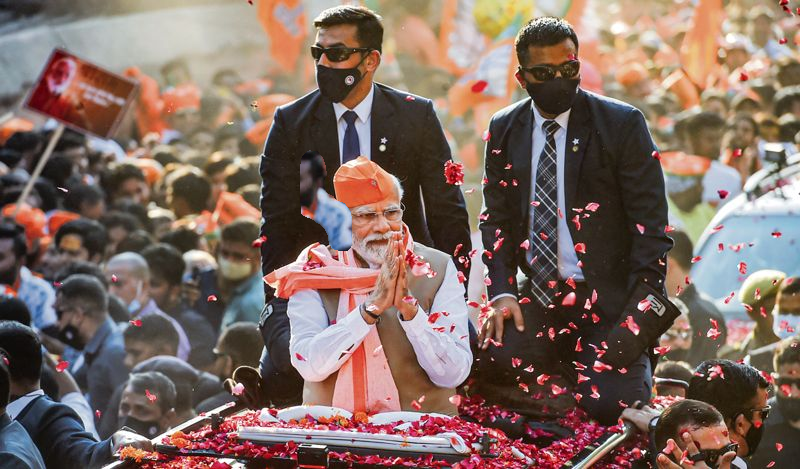

204 260 157 226


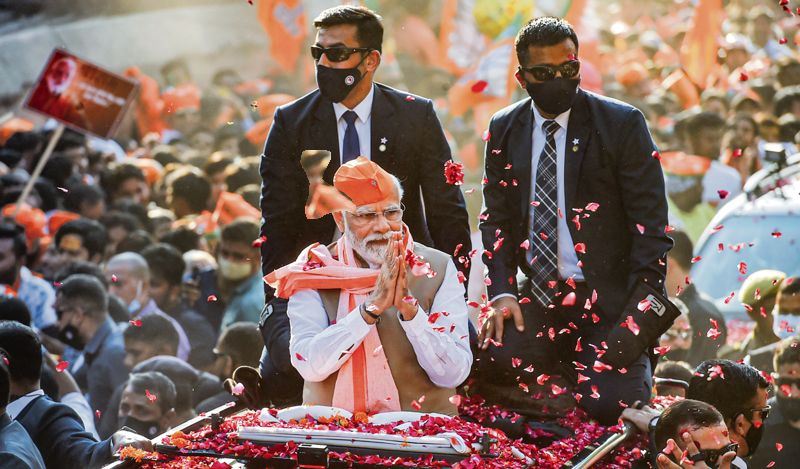

146 215 246 362


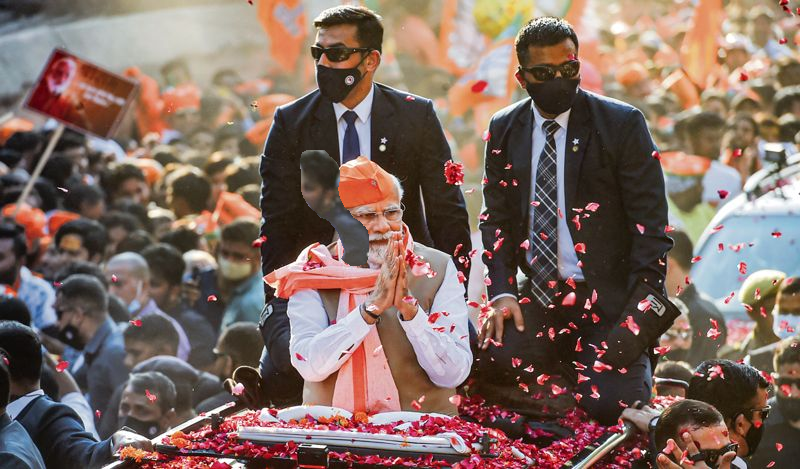

113 534 406 467


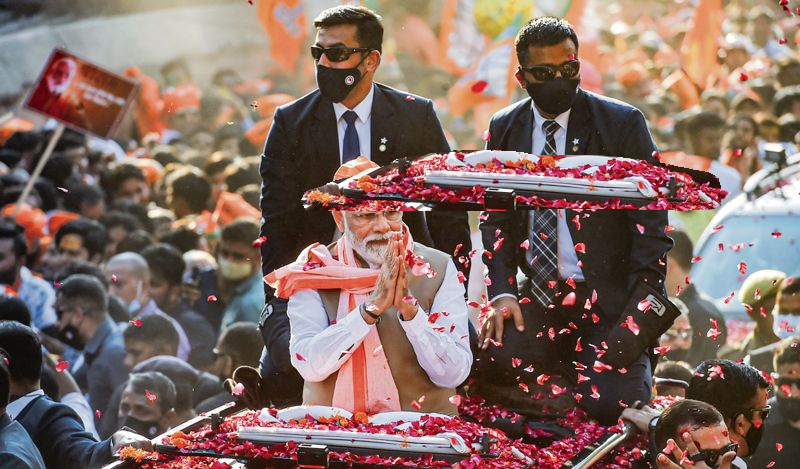

257 351 128 408


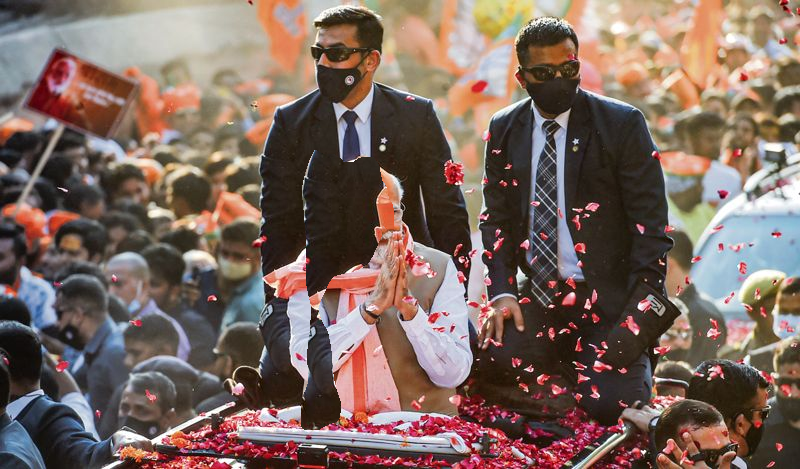

103 150 163 229


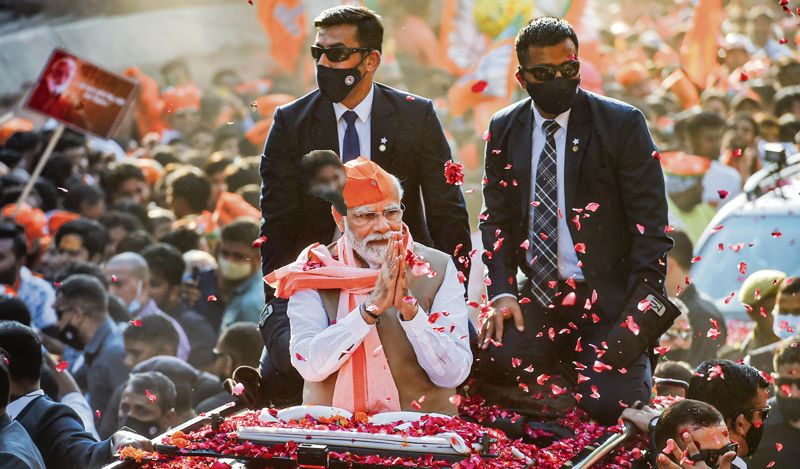

211 263 322 376


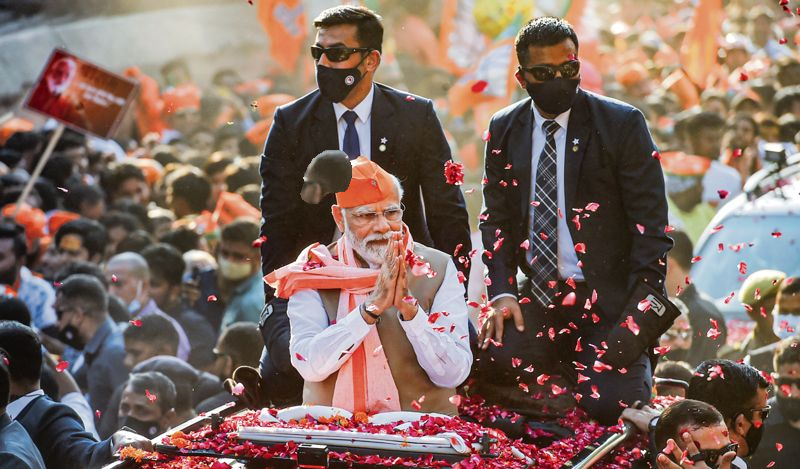

666 727 228 364


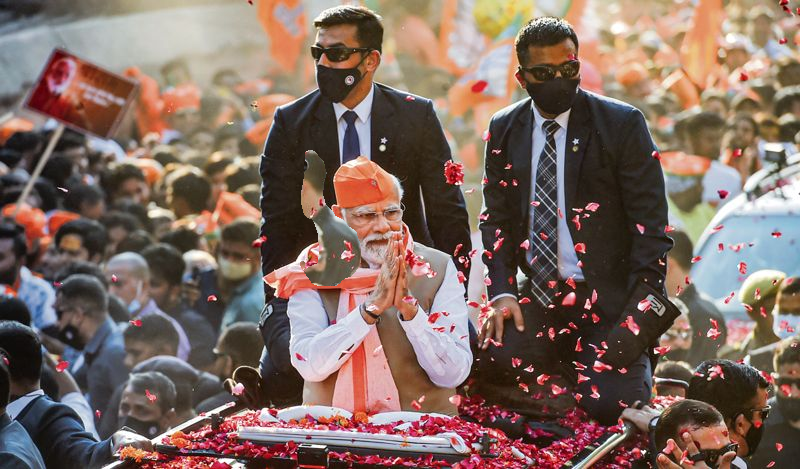

654 687 380 395


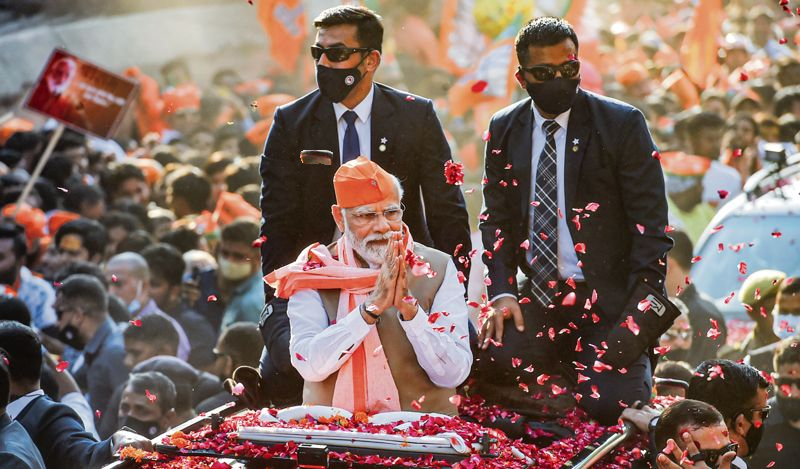

164 211 165 231


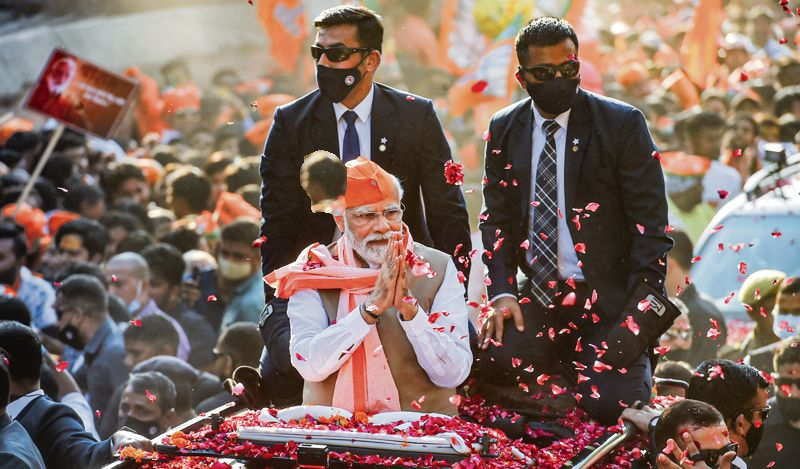

49 107 219 264


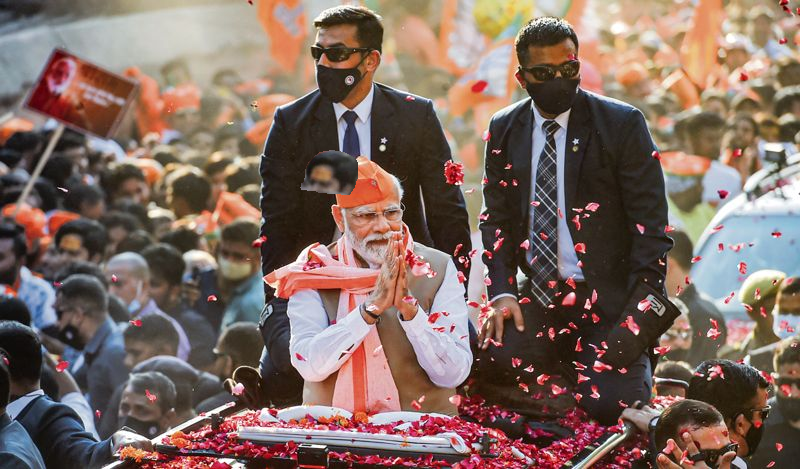

124 185 315 364


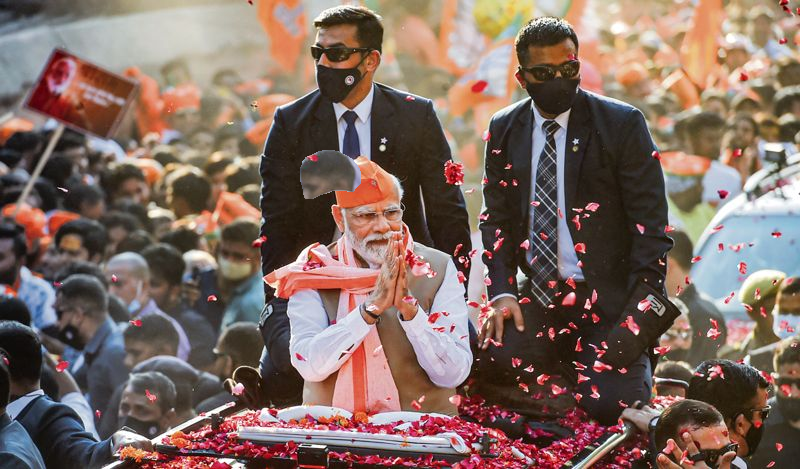

748 789 10 60


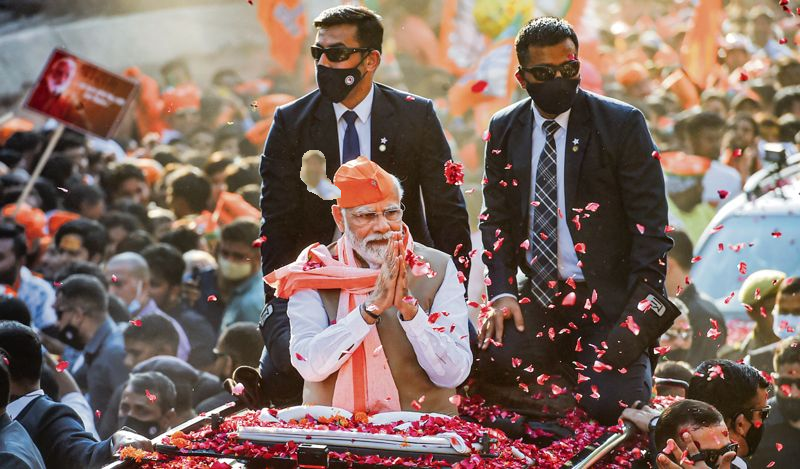

173 252 176 234


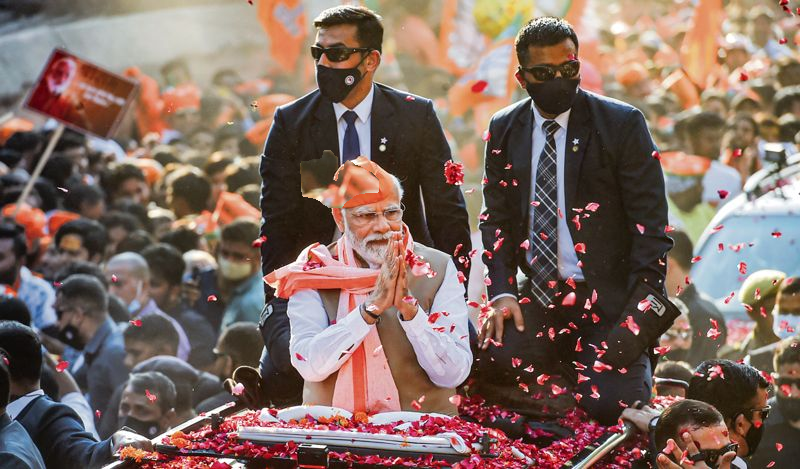

48 104 185 234


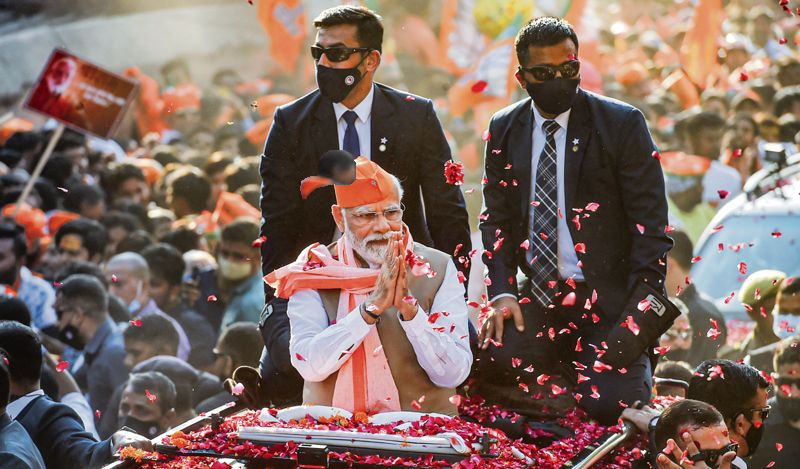

654 692 361 388


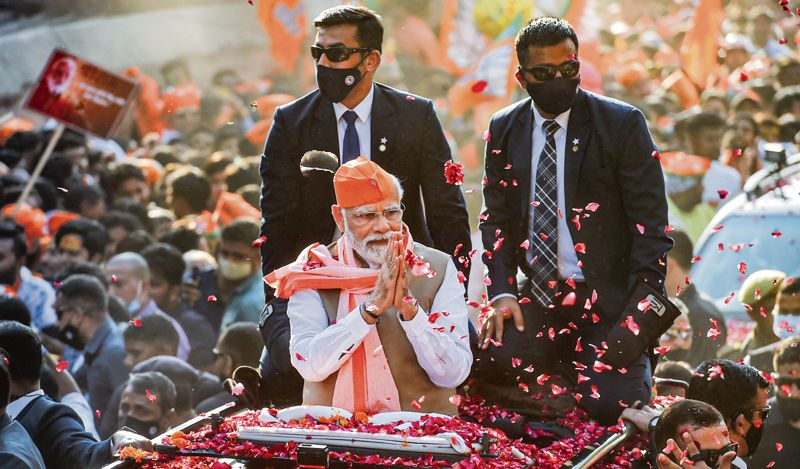

In [ ]:
#not suitable results

from PIL import Image
import numpy as np
# Get the masks
masks = np.asarray(outputs["instances"].pred_masks.to("cpu"))
for i in range(count):
# Pick an item to mask
  item_mask = masks[i]

  # Get the true bounding box of the mask (not the same as the bbox prediction)
  segmentation = np.where(item_mask == True)
  x_min = int(np.min(segmentation[1]))
  x_max = int(np.max(segmentation[1]))
  y_min = int(np.min(segmentation[0]))
  y_max = int(np.max(segmentation[0]))
  print(x_min, x_max, y_min, y_max)

  # Create a cropped image from just the portion of the image we want
  cropped = Image.fromarray(image[y_min:y_max, x_min:x_max, :], mode='RGB')

  # # Create a PIL image out of the mask
  mask = Image.fromarray((item_mask * 255).astype('uint8'))

  # # Crop the mask to match the cropped image
  cropped_mask = mask.crop((x_min, y_min, x_max, y_max))

  # # Load in a background image and choose a paste position
  background = Image.fromarray(image, mode='RGB')


  paste_position = (300, 150)

  #Create a new foreground image as large as the composite and paste the cropped image on top
  new_fg_image = Image.new('RGB', background.size)
  new_fg_image.paste(cropped, paste_position)

  # # Create a new alpha mask as large as the composite and paste the cropped mask
  new_alpha_mask = Image.new('L', background.size, color = 0)
  new_alpha_mask.paste(cropped_mask, paste_position)

  # # Compose the foreground and background using the alpha mask
  # composite = Image.composite(new_fg_image, background, new_alpha_mask)
  composite = Image.composite(new_fg_image, background,new_alpha_mask)
  # Display the image
  cv2_imshow(np.array(composite))


0


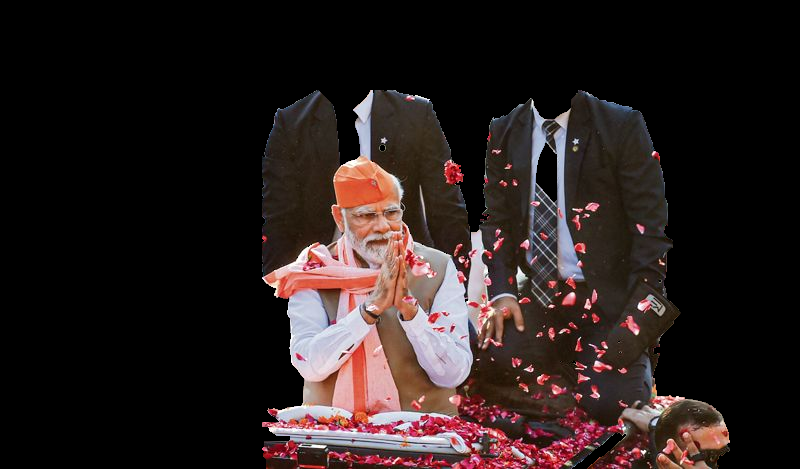

1


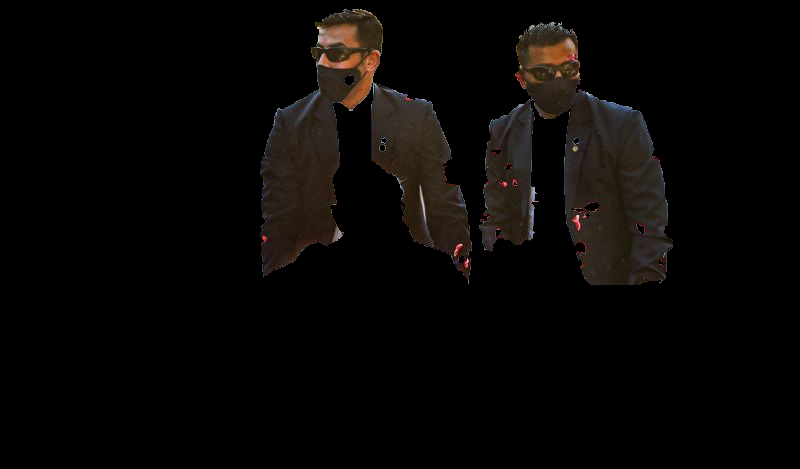

2


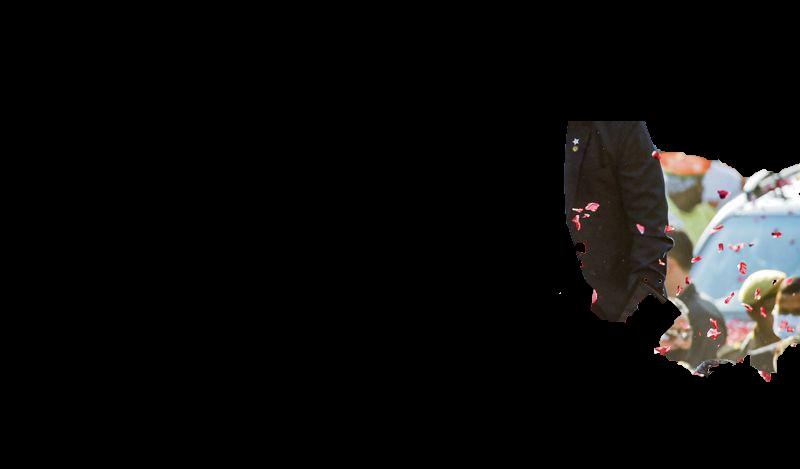

3


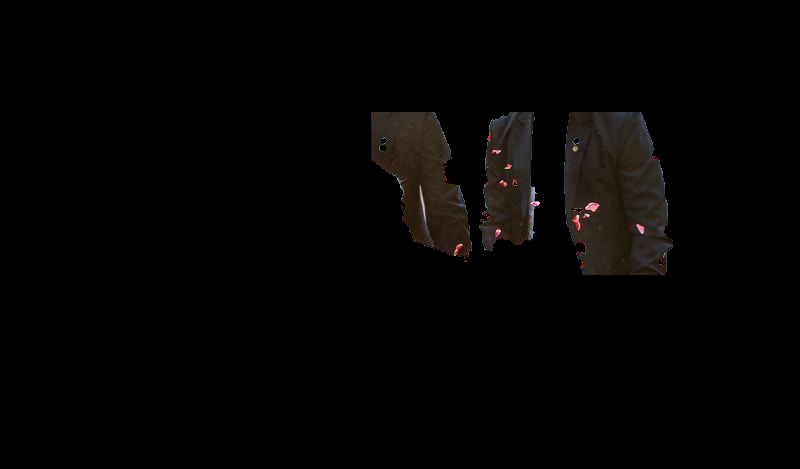

4


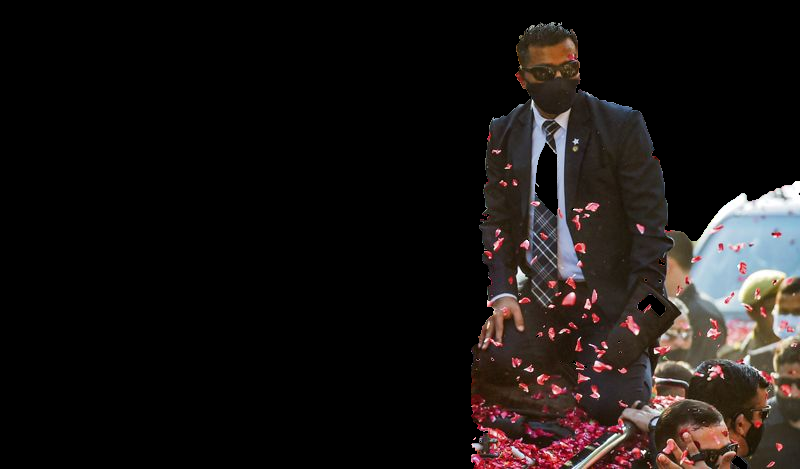

5


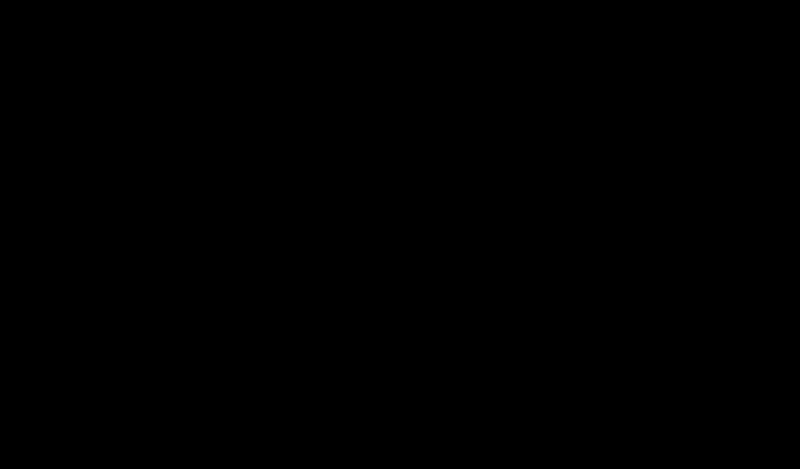

6


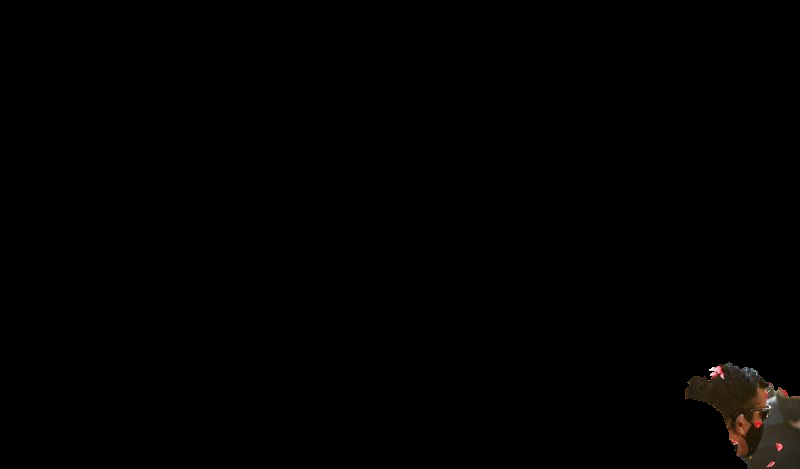

7


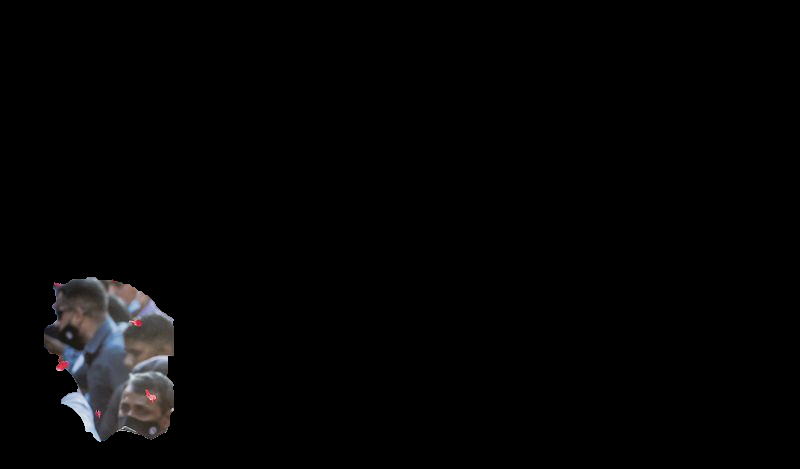

8


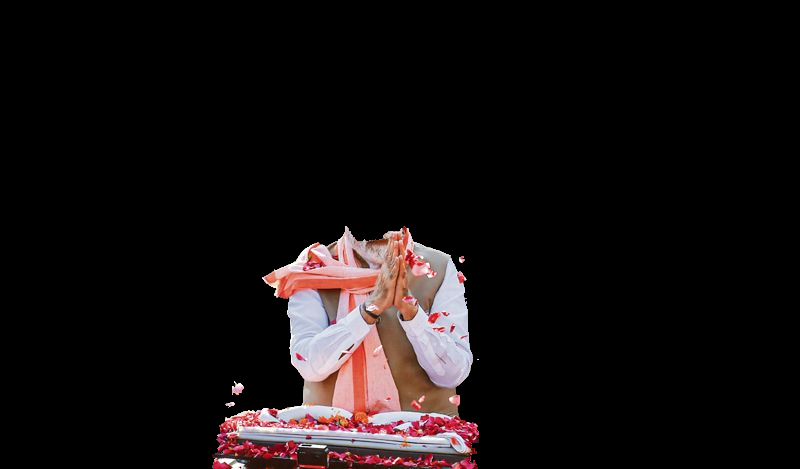

9


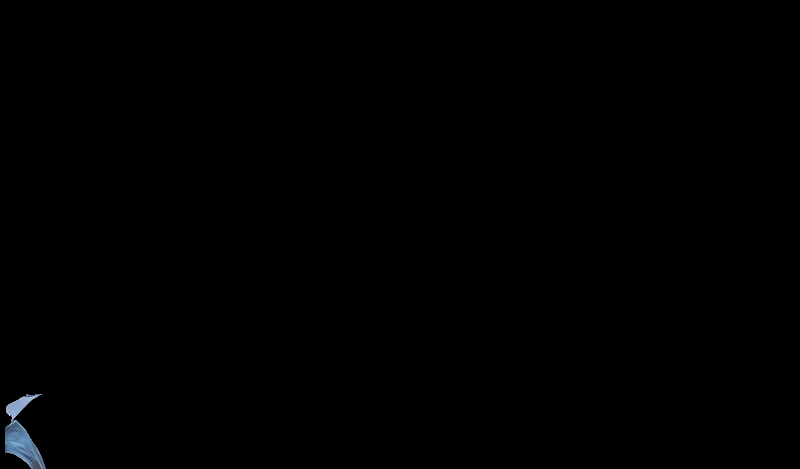

10


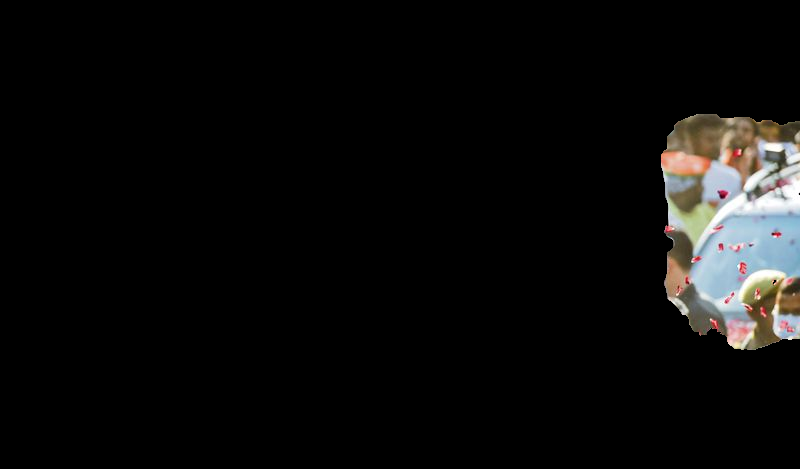

11


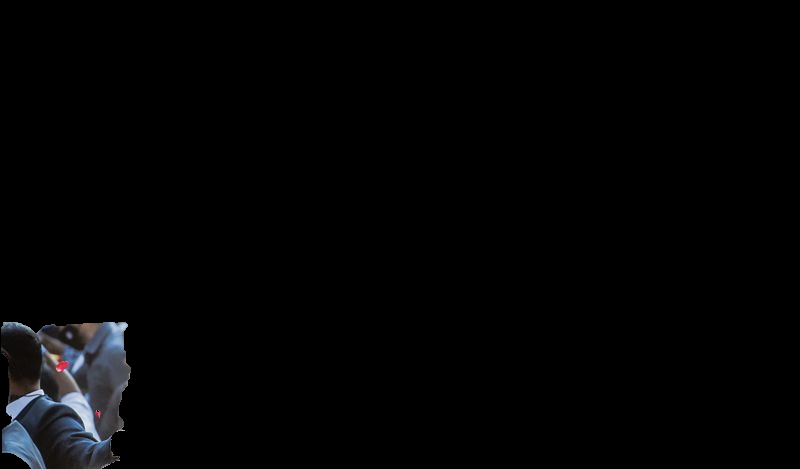

12


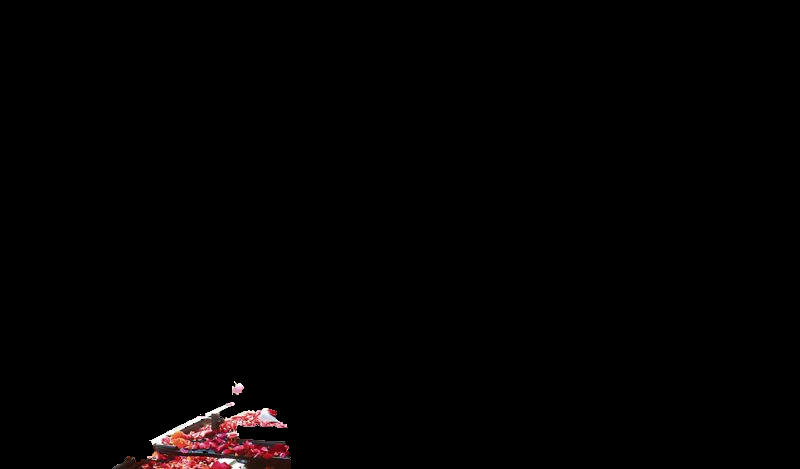

13


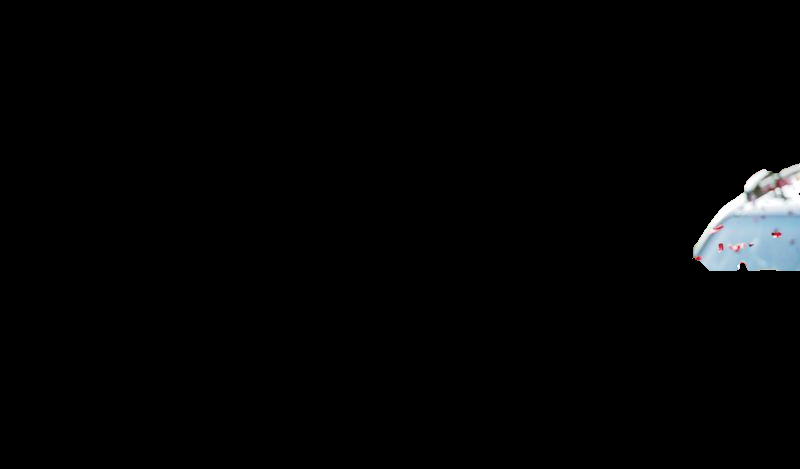

14


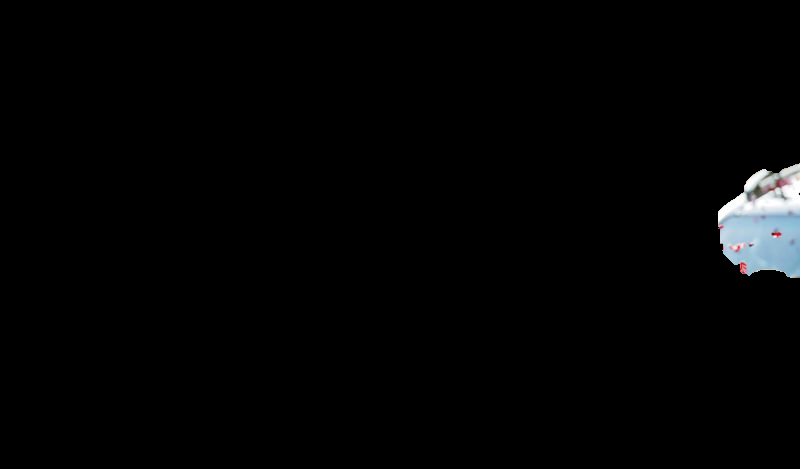

15


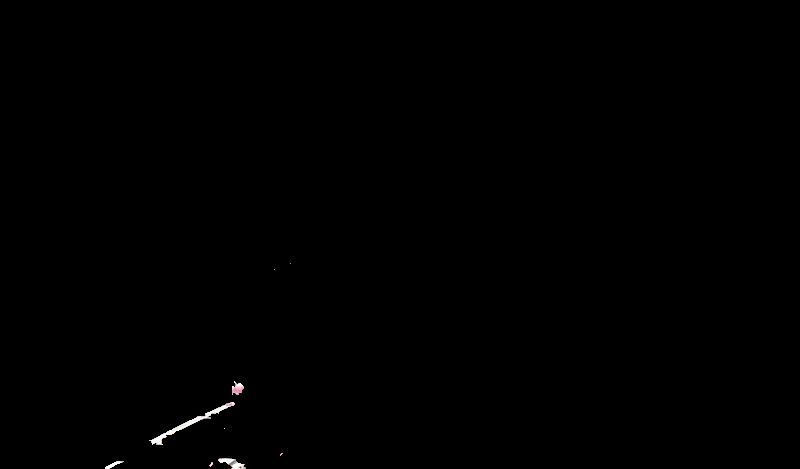

16


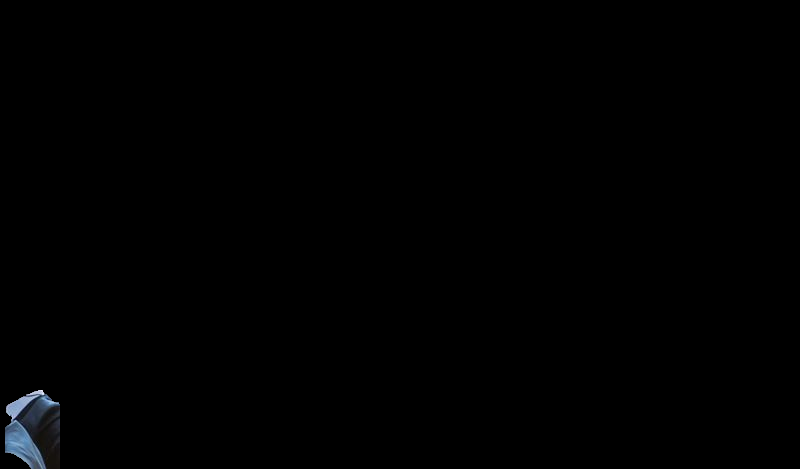

17


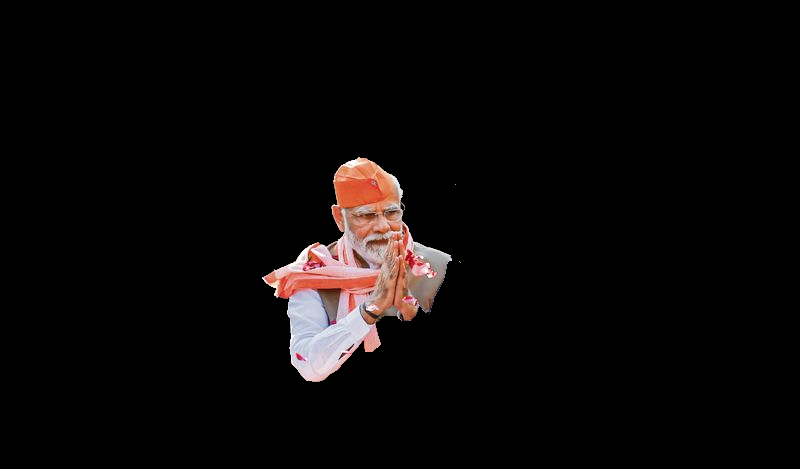

18


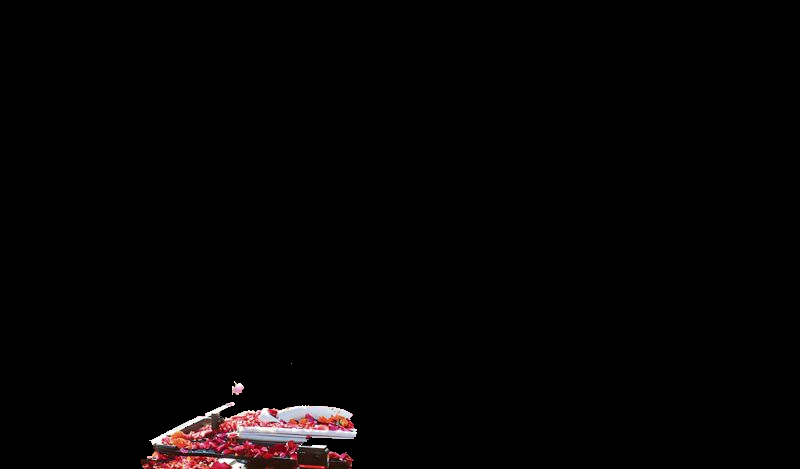

19


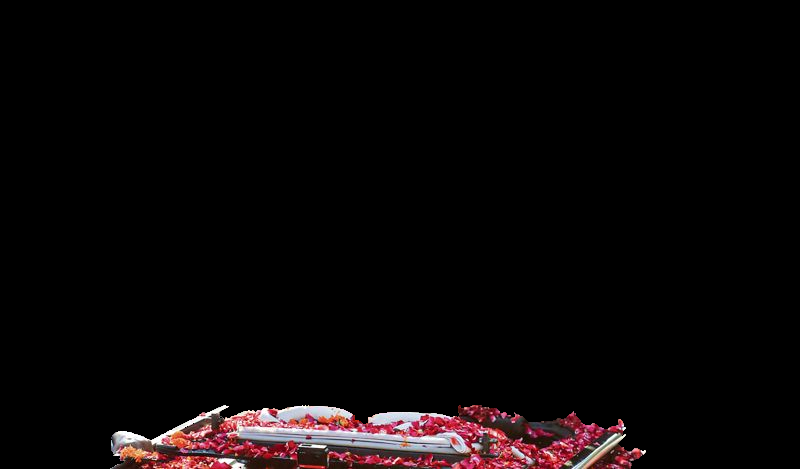

20


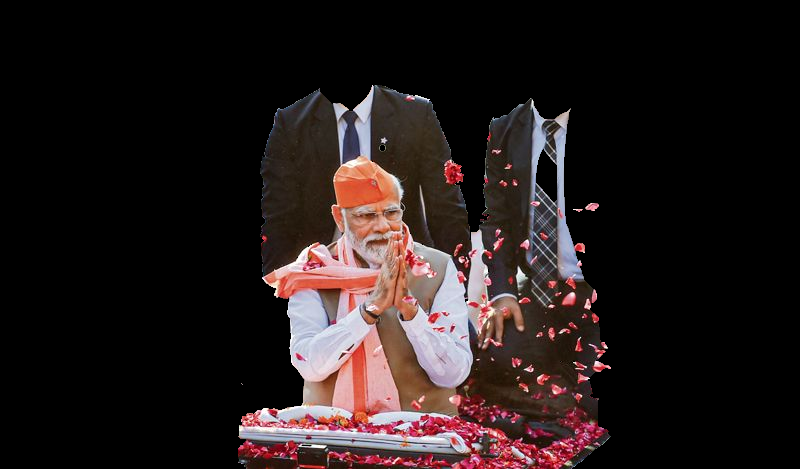

21


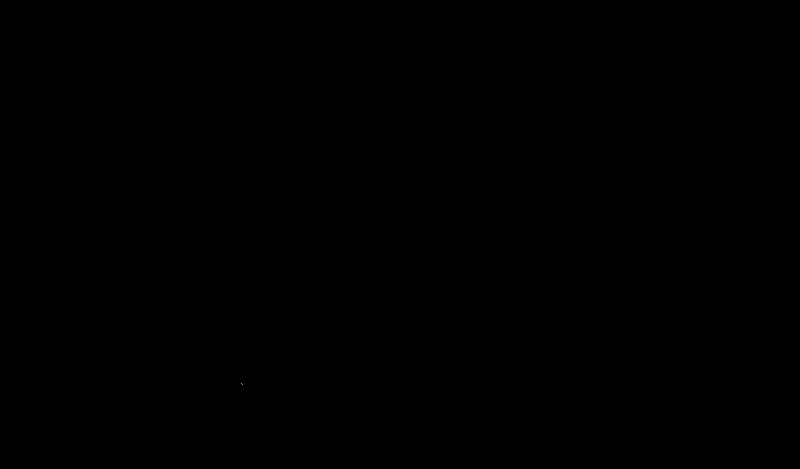

22


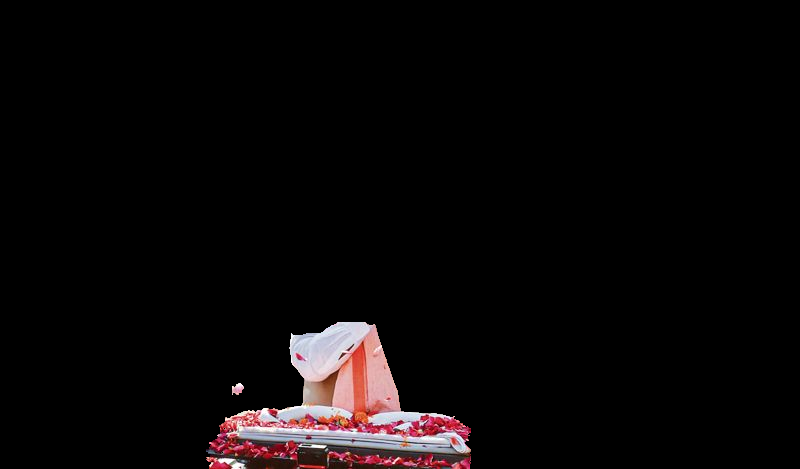

23


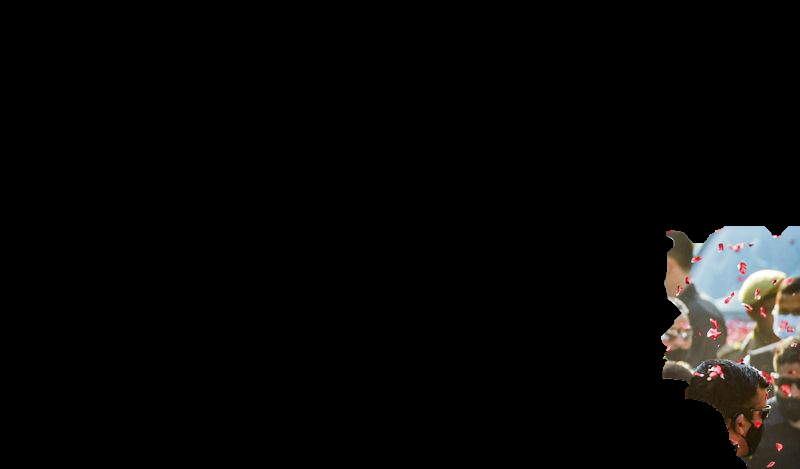

24


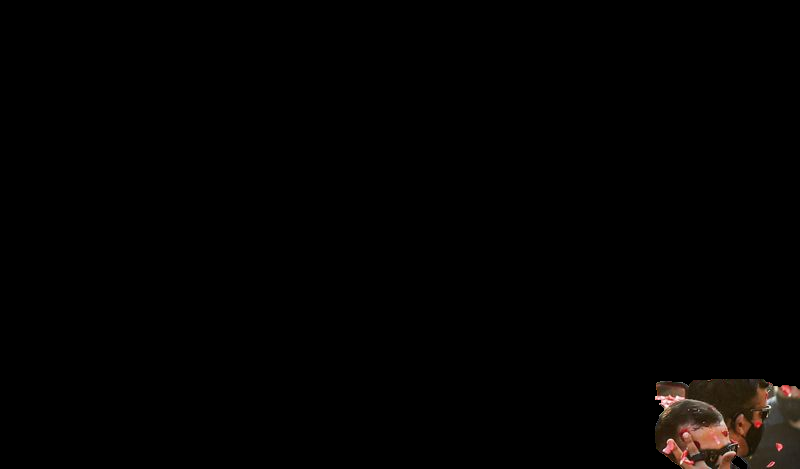

25


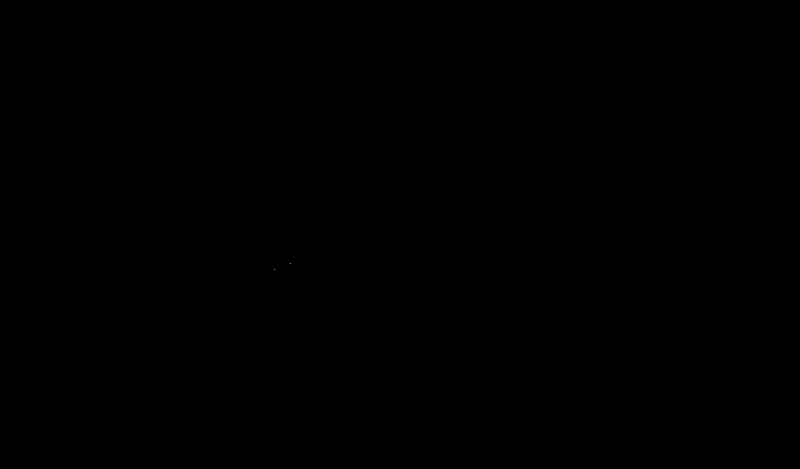

26


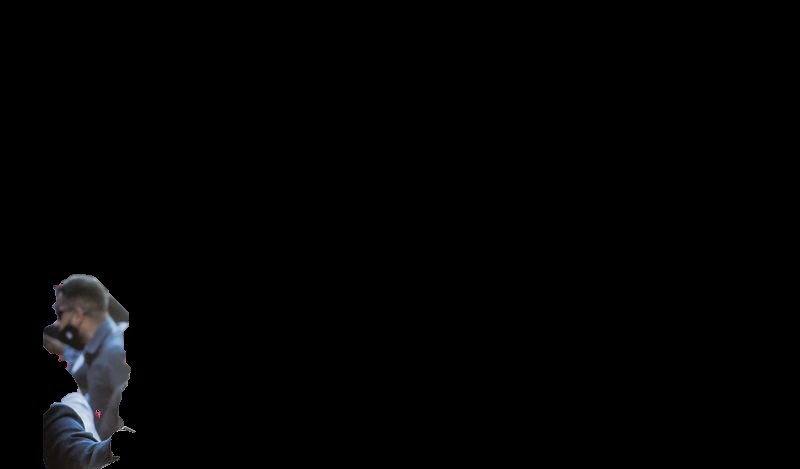

27


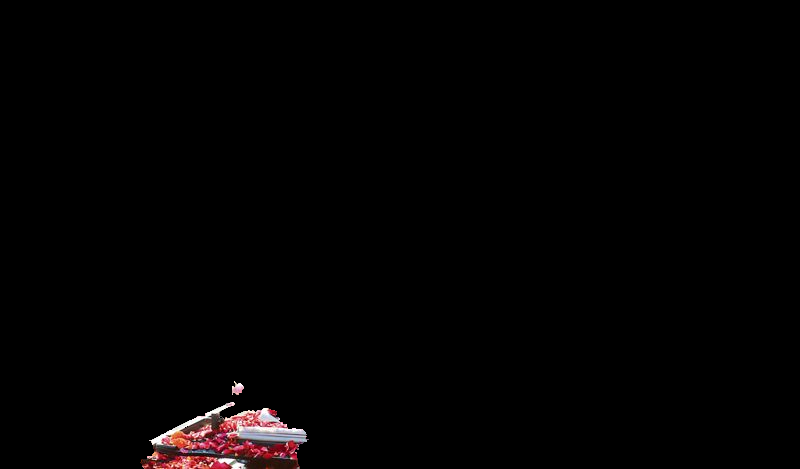

28


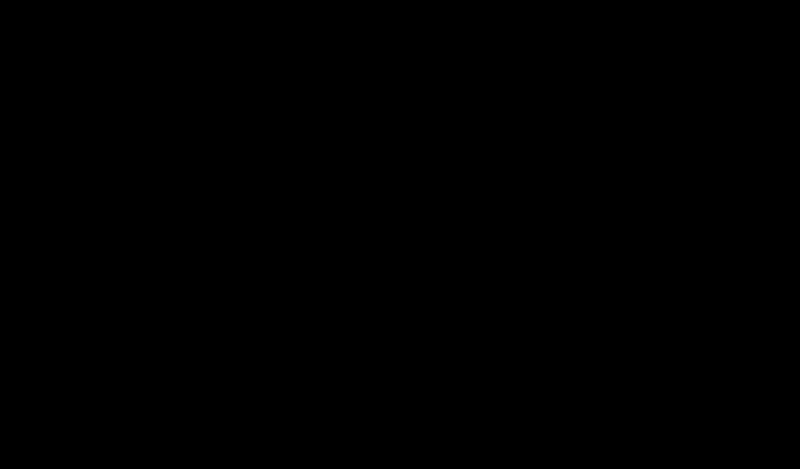

29


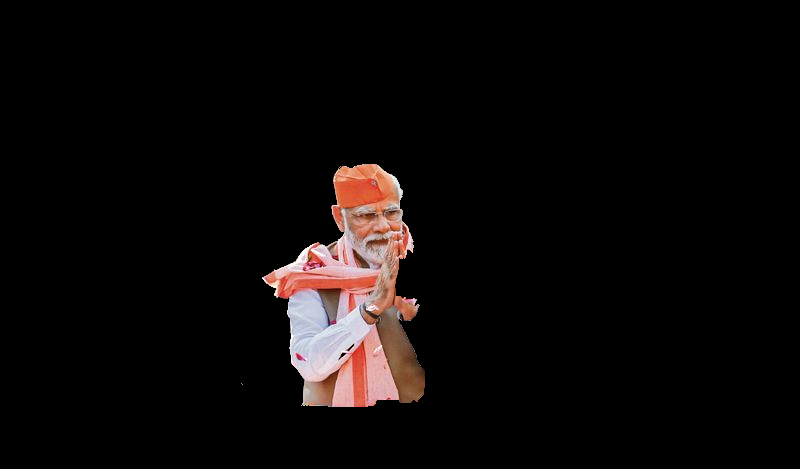

30


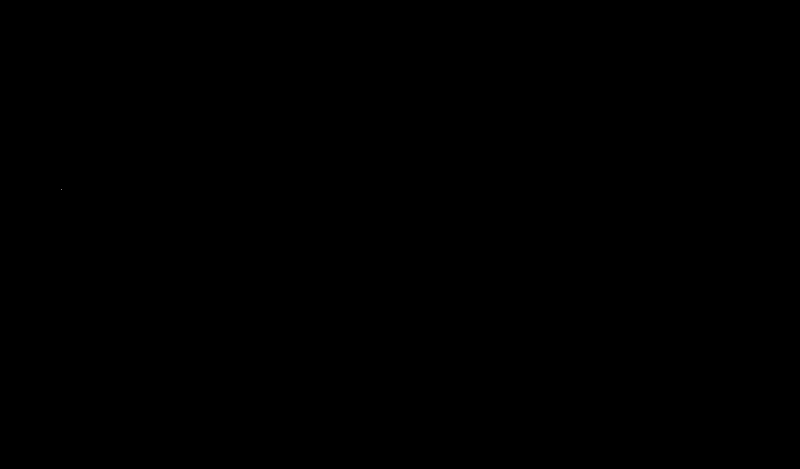

31


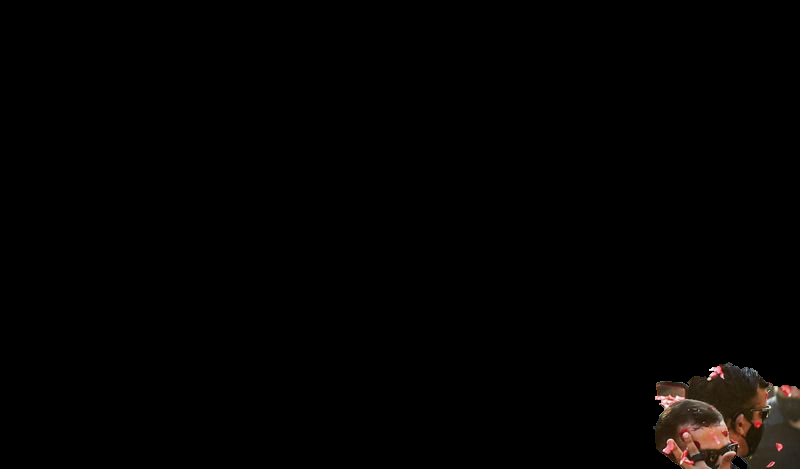

In [ ]:
#failed attempt using grabcut
import re
import numpy as np
for i in range(count):
  print(i)
  mask =np.zeros(image.shape[:2],np.uint8)
  bgdModel = np.zeros((1,65),np.float64)
  fgdModel = np.zeros((1,65),np.float64)
  rect=outputs["instances"].pred_boxes[i]
  rect=str(rect)
  rect=re.findall("\d+\.\d+",rect)
  rect = [round(float(i)) for i in rect]
  cv2.grabCut(image,mask,rect,bgdModel,fgdModel,5,cv2.GC_INIT_WITH_RECT)
  mask2 = np.where((mask==2)|(mask==0),0,1).astype('uint8')
  img = image*mask2[:,:,np.newaxis]
  cv2_imshow(img)

person detection number 1


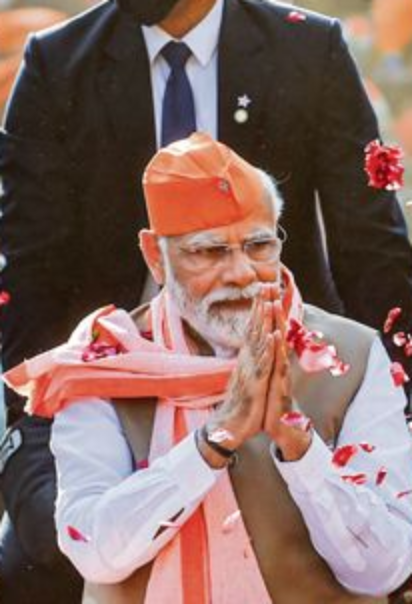

person detection number 2


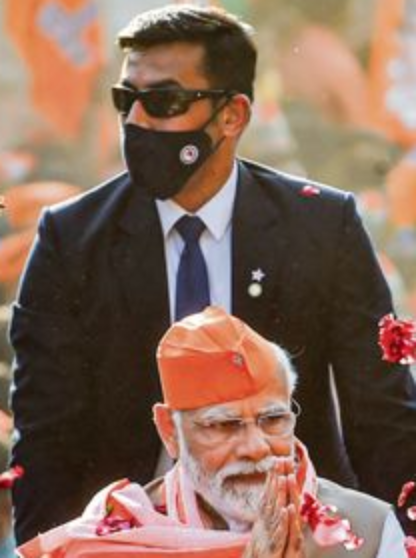

tie detection number 3


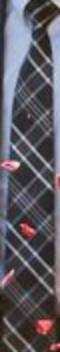

tie detection number 4


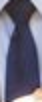

person detection number 5


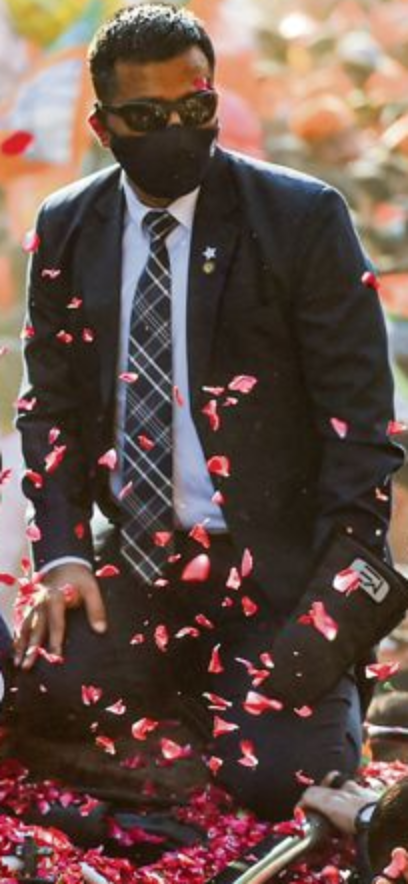

person detection number 6


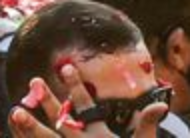

person detection number 7


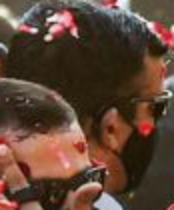

person detection number 8


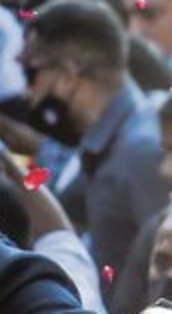

person detection number 9


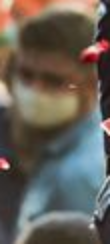

person detection number 10


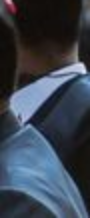

person detection number 11


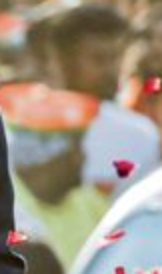

person detection number 12


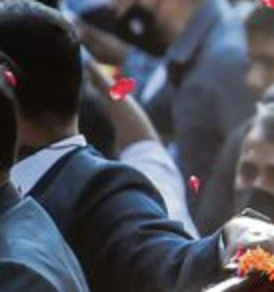

person detection number 13


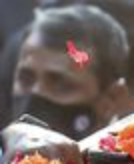

person detection number 14


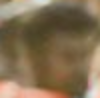

person detection number 15


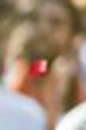

person detection number 16


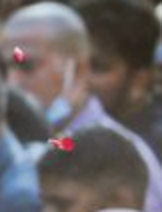

person detection number 17


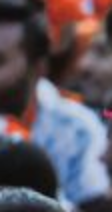

person detection number 18


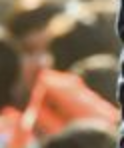

person detection number 19


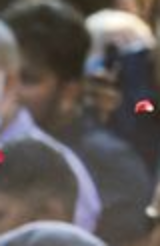

dining table detection number 20


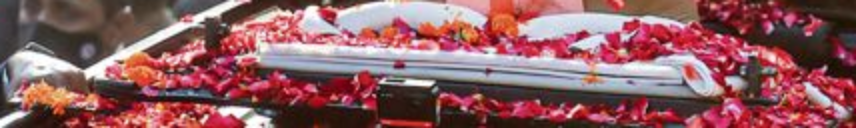

person detection number 21


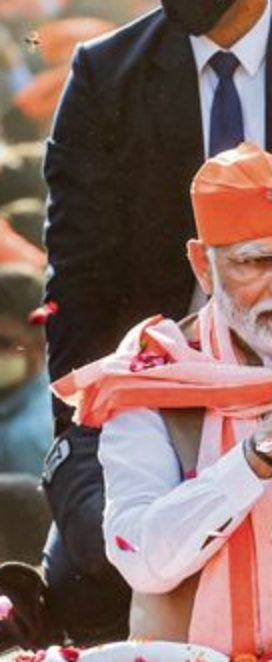

person detection number 22


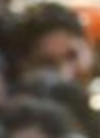

person detection number 23


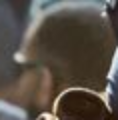

person detection number 24


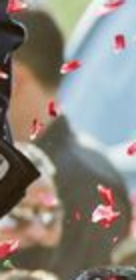

chair detection number 25


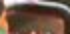

person detection number 26


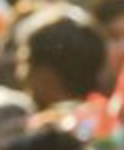

person detection number 27


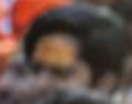

person detection number 28


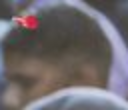

person detection number 29


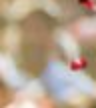

person detection number 30


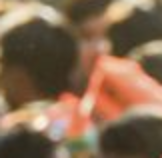

person detection number 31


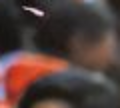

person detection number 32


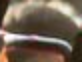

In [ ]:
#for simple cropping
# code to get class name
prediction_boxes = outputs["instances"].pred_boxes
detected_class_indexes = outputs["instances"].pred_classes

metadata = MetadataCatalog.get(cfg.DATASETS.TRAIN[0])
class_catalog = metadata.thing_classes

for idx, coordinates in enumerate(prediction_boxes):
    class_index = detected_class_indexes[idx]
    class_name = class_catalog[class_index]
    rect=outputs["instances"].pred_boxes[idx]
    rect=str(rect)
    rect=re.findall("\d+\.\d+",rect)
    rect = [round(float(i)) for i in rect]
    minx, miny, maxx, maxy = [t for t in rect]
    cropped_image = image[miny:maxy, minx:maxx]
    large = cv2.resize(cropped_image, (0,0), fx=2, fy=2)
    print(class_name+" detection number",idx+1)
    cv2_imshow(large)
  
   

## THANK YOU PART 1 [HERE](https://)



